IMPORTING ALL REQUIRED LIBRARIES

In [54]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
from nltk.stem.porter import PorterStemmer
nltk.download('stopwords')
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score
from wordcloud import WordCloud
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
import pickle
import re
from sklearn.feature_extraction.text import CountVectorizer


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\LENOVO\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [37]:
data = pd.read_csv('C:\\Users\\LENOVO\\Desktop\\SENTIMENTAL ANALYSIS\\amazon.csv', delimiter='\t', quoting=3)
print(f"Dataset shape : {data.shape}")

Dataset shape : (1465, 1)


In [1]:
import pandas as pd

# Read the dataset into a DataFrame
data = pd.read_csv('C:\\Users\\LENOVO\\Desktop\\SENTIMENTAL ANALYSIS\\amazon.csv') 

# Print the column names in your DataFrame
print("Column names in DataFrame:", data.columns)

# Update the list of columns to concatenate based on the printed column names
columns_to_concat = ['product_id	product_name	category	discounted_price	actual_price	discount_percentage	rating feedback rating_count	about_product	user_id	user_name	review_id	review_title	review_content	img_link	product_link']




Column names in DataFrame: Index(['product_id', 'product_name', 'category', 'discounted_price',
       'actual_price', 'discount_percentage', 'rating', 'feedback',
       'rating_count', 'about_product', 'user_id', 'user_name', 'review_id',
       'review_title', 'review_content', 'img_link', 'product_link'],
      dtype='object')


In [2]:
data.head()

,product_id,product_name,category,discounted_price,actual_price,discount_percentage,rating,feedback,rating_count,about_product,user_id,user_name,review_id,review_title,review_content,img_link,product_link
0,B07JW9H4J1,Wayona Nylon Braided USB to Lightning Fast Cha...,Computers&Accessories|Accessories&Peripherals|...,₹399,"₹1,099",64%,4.2,1,"24,269",High Compatibility : Compatible With iPhone 12...,"AG3D6O4STAQKAY2UVGEUV46KN35Q,AHMY5CWJMMK5BJRBB...","Manav,Adarsh gupta,Sundeep,S.Sayeed Ahmed,jasp...","R3HXWT0LRP0NMF,R2AJM3LFTLZHFO,R6AQJGUP6P86,R1K...","Satisfied,Charging is really fast,Value for mo...",Looks durable Charging is fine tooNo complains...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Wayona-Braided-WN3LG1-Sy...
1,B098NS6PVG,Ambrane Unbreakable 60W / 3A Fast Charging 1.5...,Computers&Accessories|Accessories&Peripherals|...,₹199,₹349,43%,4,1,"43,994","Compatible with all Type C enabled devices, be...","AECPFYFQVRUWC3KGNLJIOREFP5LQ,AGYYVPDD7YG7FYNBX...","ArdKn,Nirbhay kumar,Sagar Viswanathan,Asp,Plac...","RGIQEG07R9HS2,R1SMWZQ86XIN8U,R2J3Y1WL29GWDE,RY...","A Good Braided Cable for Your Type C Device,Go...",I ordered this cable to connect my phone to An...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Ambrane-Unbreakable-Char...
2,B096MSW6CT,Sounce Fast Phone Charging Cable & Data Sync U...,Computers&Accessories|Accessories&Peripherals|...,₹199,"₹1,899",90%,3.9,0,"7,928",【 Fast Charger& Data Sync】-With built-in safet...,"AGU3BBQ2V2DDAMOAKGFAWDDQ6QHA,AESFLDV2PT363T2AQ...","Kunal,Himanshu,viswanath,sai niharka,saqib mal...","R3J3EQQ9TZI5ZJ,R3E7WBGK7ID0KV,RWU79XKQ6I1QF,R2...","Good speed for earlier versions,Good Product,W...","Not quite durable and sturdy,https://m.media-a...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Sounce-iPhone-Charging-C...
3,B08HDJ86NZ,boAt Deuce USB 300 2 in 1 Type-C & Micro USB S...,Computers&Accessories|Accessories&Peripherals|...,₹329,₹699,53%,4.2,1,"94,363",The boAt Deuce USB 300 2 in 1 cable is compati...,"AEWAZDZZJLQUYVOVGBEUKSLXHQ5A,AG5HTSFRRE6NL3M5S...","Omkar dhale,JD,HEMALATHA,Ajwadh a.,amar singh ...","R3EEUZKKK9J36I,R3HJVYCLYOY554,REDECAZ7AMPQC,R1...","Good product,Good one,Nice,Really nice product...","Good product,long wire,Charges good,Nice,I bou...",https://m.media-amazon.com/images/I/41V5FtEWPk...,https://www.amazon.in/Deuce-300-Resistant-Tang...
4,B08CF3B7N1,Portronics Konnect L 1.2M Fast Charging 3A 8 P...,Computers&Accessories|Accessories&Peripherals|...,₹154,₹399,61%,4.2,1,"16,905",[CHARGE & SYNC FUNCTION]- This cable comes wit...,"AE3Q6KSUK5P75D5HFYHCRAOLODSA,AFUGIFH5ZAFXRDSZH...","rahuls6099,Swasat Borah,Ajay Wadke,Pranali,RVK...","R1BP4L2HH9TFUP,R16PVJEXKV6QZS,R2UPDB81N66T4P,R...","As good as original,Decent,Good one for second...","Bought this instead of original apple, does th...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Portronics-Konnect-POR-1...


In [3]:
print(f"Feature names : {data.columns.values}")

Feature names : ['product_id' 'product_name' 'category' 'discounted_price' 'actual_price'
 'discount_percentage' 'rating' 'feedback' 'rating_count' 'about_product'
 'user_id' 'user_name' 'review_id' 'review_title' 'review_content'
 'img_link' 'product_link']


In [4]:
data.isnull().sum()

product_id             0
product_name           0
category               0
discounted_price       0
actual_price           0
discount_percentage    0
rating                 0
feedback               0
rating_count           2
about_product          0
user_id                0
user_name              0
review_id              0
review_title           0
review_content         0
img_link               0
product_link           0
dtype: int64

In [5]:
#Getting the record where 'verified_reviews' is null 

data[data['review_content'].isna() == True]

,product_id,product_name,category,discounted_price,actual_price,discount_percentage,rating,feedback,rating_count,about_product,user_id,user_name,review_id,review_title,review_content,img_link,product_link


In [6]:
data.dropna(inplace=True)

In [7]:
print(f"Dataset shape after dropping null values : {data.shape}") 

Dataset shape after dropping null values : (1463, 17)


In [8]:
print(data.columns)


Index(['product_id', 'product_name', 'category', 'discounted_price',
       'actual_price', 'discount_percentage', 'rating', 'feedback',
       'rating_count', 'about_product', 'user_id', 'user_name', 'review_id',
       'review_title', 'review_content', 'img_link', 'product_link'],
      dtype='object')


In [9]:
data['length'] = data['review_content'].apply(len)

In [10]:
data.head()

,product_id,product_name,category,discounted_price,actual_price,discount_percentage,rating,feedback,rating_count,about_product,user_id,user_name,review_id,review_title,review_content,img_link,product_link,length
0,B07JW9H4J1,Wayona Nylon Braided USB to Lightning Fast Cha...,Computers&Accessories|Accessories&Peripherals|...,₹399,"₹1,099",64%,4.2,1,"24,269",High Compatibility : Compatible With iPhone 12...,"AG3D6O4STAQKAY2UVGEUV46KN35Q,AHMY5CWJMMK5BJRBB...","Manav,Adarsh gupta,Sundeep,S.Sayeed Ahmed,jasp...","R3HXWT0LRP0NMF,R2AJM3LFTLZHFO,R6AQJGUP6P86,R1K...","Satisfied,Charging is really fast,Value for mo...",Looks durable Charging is fine tooNo complains...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Wayona-Braided-WN3LG1-Sy...,483
1,B098NS6PVG,Ambrane Unbreakable 60W / 3A Fast Charging 1.5...,Computers&Accessories|Accessories&Peripherals|...,₹199,₹349,43%,4,1,"43,994","Compatible with all Type C enabled devices, be...","AECPFYFQVRUWC3KGNLJIOREFP5LQ,AGYYVPDD7YG7FYNBX...","ArdKn,Nirbhay kumar,Sagar Viswanathan,Asp,Plac...","RGIQEG07R9HS2,R1SMWZQ86XIN8U,R2J3Y1WL29GWDE,RY...","A Good Braided Cable for Your Type C Device,Go...",I ordered this cable to connect my phone to An...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Ambrane-Unbreakable-Char...,1186
2,B096MSW6CT,Sounce Fast Phone Charging Cable & Data Sync U...,Computers&Accessories|Accessories&Peripherals|...,₹199,"₹1,899",90%,3.9,0,"7,928",【 Fast Charger& Data Sync】-With built-in safet...,"AGU3BBQ2V2DDAMOAKGFAWDDQ6QHA,AESFLDV2PT363T2AQ...","Kunal,Himanshu,viswanath,sai niharka,saqib mal...","R3J3EQQ9TZI5ZJ,R3E7WBGK7ID0KV,RWU79XKQ6I1QF,R2...","Good speed for earlier versions,Good Product,W...","Not quite durable and sturdy,https://m.media-a...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Sounce-iPhone-Charging-C...,271
3,B08HDJ86NZ,boAt Deuce USB 300 2 in 1 Type-C & Micro USB S...,Computers&Accessories|Accessories&Peripherals|...,₹329,₹699,53%,4.2,1,"94,363",The boAt Deuce USB 300 2 in 1 cable is compati...,"AEWAZDZZJLQUYVOVGBEUKSLXHQ5A,AG5HTSFRRE6NL3M5S...","Omkar dhale,JD,HEMALATHA,Ajwadh a.,amar singh ...","R3EEUZKKK9J36I,R3HJVYCLYOY554,REDECAZ7AMPQC,R1...","Good product,Good one,Nice,Really nice product...","Good product,long wire,Charges good,Nice,I bou...",https://m.media-amazon.com/images/I/41V5FtEWPk...,https://www.amazon.in/Deuce-300-Resistant-Tang...,443
4,B08CF3B7N1,Portronics Konnect L 1.2M Fast Charging 3A 8 P...,Computers&Accessories|Accessories&Peripherals|...,₹154,₹399,61%,4.2,1,"16,905",[CHARGE & SYNC FUNCTION]- This cable comes wit...,"AE3Q6KSUK5P75D5HFYHCRAOLODSA,AFUGIFH5ZAFXRDSZH...","rahuls6099,Swasat Borah,Ajay Wadke,Pranali,RVK...","R1BP4L2HH9TFUP,R16PVJEXKV6QZS,R2UPDB81N66T4P,R...","As good as original,Decent,Good one for second...","Bought this instead of original apple, does th...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Portronics-Konnect-POR-1...,2451


In [11]:
#Randomly checking for 10th record

print(f"'review_content' column value: {data.iloc[10]['review_content']}") #Original value
print(f"Length of review : {len(data.iloc[10]['review_content'])}") #Length of review using len()
print(f"'length' column value : {data.iloc[10]['length']}") #Value of the column 'length'

'review_content' column value: The cable is efficient in fast charging but in quick data transfer. Overall fine.,I like the usb c  L shape. Nylon Shielded core wire it improves the life of the cable.,i think i buy these every 6 months or so. fast charging stops working after a while. probbly something to do with the cable design. the cable gets twisted over time and I suspect that breaks the high capacity wires inside. but i keep buying it because there arent too many options in an L shaped design,Good and durable product. Sometime the charges doesn't work on few adapters. there might be few cut off or something but works fine on apple adapter, Car charger, USB,The product is really good at affordable price.,Good and fast charging, and value for money,பொருள் உடைய கடினத்தன்மையின் நன்றாக உள்ளது சார்ஜ் ஏறும் வேகம் 15wat,Not a fast charger.  Very slow charging with 65w.  L-shape pin is very useful.
Length of review : 876
'length' column value : 876


We can see that the length of review is the same as the value in the length column for that record

In [12]:
data.dtypes

product_id             object
product_name           object
category               object
discounted_price       object
actual_price           object
discount_percentage    object
rating                 object
feedback                int64
rating_count           object
about_product          object
user_id                object
user_name              object
review_id              object
review_title           object
review_content         object
img_link               object
product_link           object
length                  int64
dtype: object

In [13]:
len(data)

1463

In [14]:
print(f"Rating value count: \n{data['rating'].value_counts()}")

Rating value count: 
rating
4.1    244
4.3    230
4.2    228
4      181
3.9    123
4.4    123
3.8     86
4.5     75
3.7     42
3.6     35
3.5     26
4.6     17
3.3     16
3.4     10
4.7      6
3.1      4
3        3
4.8      3
3.2      2
5        2
2.8      2
2.3      1
|        1
2        1
2.6      1
2.9      1
Name: count, dtype: int64


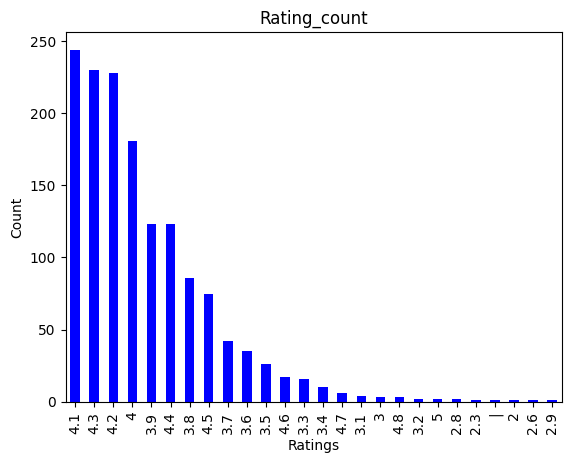

In [22]:
data['rating'].value_counts().plot.bar(color = 'blue')
plt.title('Rating_count')
plt.xlabel('Ratings')
plt.ylabel('Count')
plt.show()

In [17]:
print(f"Rating value count - percentage distribution: \n{round(data['rating'].value_counts()/data.shape[0]*100,2)}")

Rating value count - percentage distribution: 
rating
4.1    16.68
4.3    15.72
4.2    15.58
4      12.37
3.9     8.41
4.4     8.41
3.8     5.88
4.5     5.13
3.7     2.87
3.6     2.39
3.5     1.78
4.6     1.16
3.3     1.09
3.4     0.68
4.7     0.41
3.1     0.27
3       0.21
4.8     0.21
3.2     0.14
5       0.14
2.8     0.14
2.3     0.07
|       0.07
2       0.07
2.6     0.07
2.9     0.07
Name: count, dtype: float64


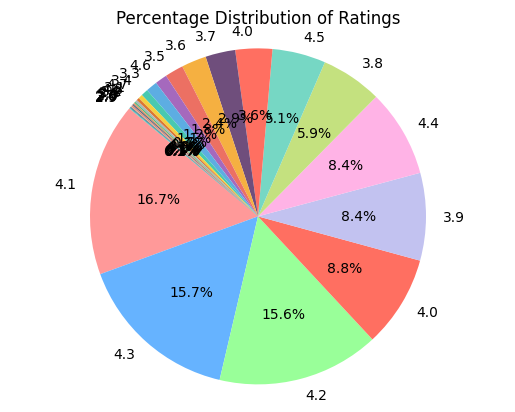

In [19]:
import matplotlib.pyplot as plt

# Data provided
ratings = [
    4.1, 4.3, 4.2, 4.0, 3.9, 4.4, 3.8, 4.5, 4.0, 3.7, 3.6, 3.5, 4.6, 3.3, 
    3.4, 4.7, 3.1, 4.8, 3.2, 2.8, 3.0, 5.0, 2.3, 3.0, 2.6, 2.9
]
percentages = [
    16.68, 15.72, 15.58, 8.82, 8.41, 8.41, 5.88, 5.13, 3.55, 2.87, 2.39, 
    1.78, 1.16, 1.09, 0.68, 0.41, 0.27, 0.21, 0.14, 0.14, 0.14, 0.14, 
    0.07, 0.07, 0.07, 0.07
]

# Define a list of colors
colors = [
    '#ff9999', '#66b3ff', '#99ff99', '#ffcc99', '#c2c2f0', '#ffb3e6', 
    '#c4e17f', '#76d7c4', '#ff6f61', '#6f4e7c', '#f5b041', '#ec7063',
    '#a569bd', '#5dade2', '#48c9b0', '#f4d03f', '#dc7633', '#aab7b8',
    '#52be80', '#e59866', '#d4ac0d', '#d98880', '#f0b27a', '#5d6d7e', 
    '#2874a6', '#48c9b0'
]

# Create a mapping from ratings to colors
rating_color_map = dict(zip(ratings, colors))

# Plotting
fig, ax = plt.subplots()

# Create a pie chart
ax.pie(percentages, labels=ratings, colors=[rating_color_map[rating] for rating in ratings], autopct='%1.1f%%', startangle=140)

# Add a title
ax.set_title('Percentage Distribution of Ratings')

# Equal aspect ratio ensures that pie is drawn as a circle.
ax.axis('equal')

# Show the plot
plt.show()


Analyzing 'feedback' column

In [21]:
#Distinct values of 'feedback' and its count 

print(f"Feedback value count: \n{data['feedback'].value_counts()}")

Feedback value count: 
feedback
1    1109
0     354
Name: count, dtype: int64


In [23]:
#Extracting the 'review_content' value for one record with feedback = 0

review_0 = data[data['feedback'] == 0].iloc[1]['review_content']
print(review_0)

It's a good product.,Like,Very good item strong and useful USB cableValue for moneyThanks to amazon and producer,https://m.media-amazon.com/images/I/51112ZRE-1L._SY88.jpg,Good,Nice product and useful product,-,Sturdy but does not support 33w charging


In [27]:
review_23 = data[data['feedback'] == 0].iloc[24]['review_content']
print(review_23)

Value of money,Usually  gd,Good Product,Good,Quality is poor and responce is late,This it what you've been looking for I guess,Quality is okk , not bed it all but it's body is not proper tight or fixed.,The product is of poor quality and seems like duplicate. Remote doesn’t work properly.



From the above 2 examples we can see that feedback 0 is negative review and 1 is positive review

Let's plot the feedback value count in a bar graph

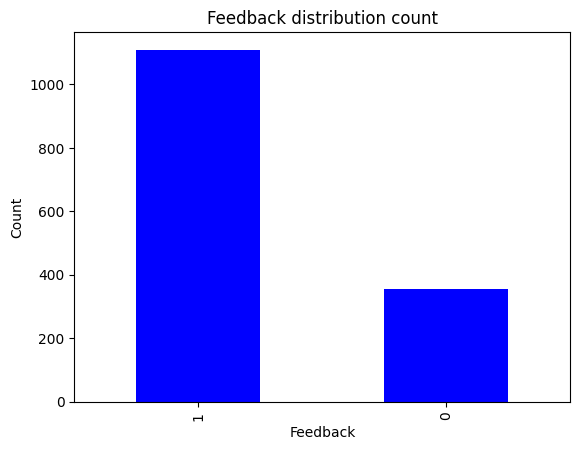

In [28]:
data['feedback'].value_counts().plot.bar(color = 'blue')
plt.title('Feedback distribution count')
plt.xlabel('Feedback')
plt.ylabel('Count')
plt.show()

In [29]:
#Finding the percentage distribution of each feedback - we'll divide the number of records for each feedback by total number of records

print(f"Feedback value count - percentage distribution: \n{round(data['feedback'].value_counts()/data.shape[0]*100,2)}")



Feedback value count - percentage distribution: 
feedback
1    75.8
0    24.2
Name: count, dtype: float64


<Axes: ylabel='Percentage wise distrubution of feedback'>

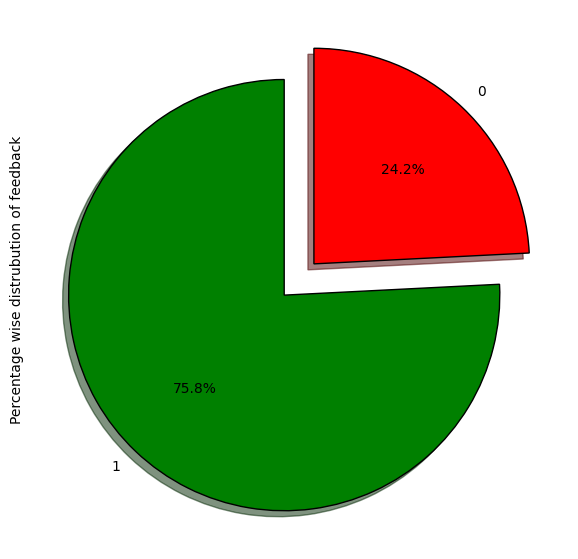

In [31]:
fig = plt.figure(figsize=(7,7))

colors = ('green', 'red')

wp = {'linewidth':1, "edgecolor":'black'}

tags = data['feedback'].value_counts()/data.shape[0]

explode=(0.1,0.1)

tags.plot(kind='pie', autopct="%1.1f%%", shadow=True, colors=colors, startangle=90, wedgeprops=wp, explode=explode, label='Percentage wise distrubution of feedback')


In [32]:
data[data['feedback'] == 0]['rating'].value_counts()

rating
3.9    123
3.8     86
3.7     42
3.6     35
3.5     26
3.3     16
3.4     10
3.1      4
3        3
3.2      2
2.8      2
2.3      1
|        1
2        1
2.6      1
2.9      1
Name: count, dtype: int64

In [33]:
data[data['feedback'] == 1]['rating'].value_counts()

rating
4.1    244
4.3    230
4.2    228
4      181
4.4    123
4.5     75
4.6     17
4.7      6
4.8      3
5        2
Name: count, dtype: int64

If rating of a review is 1 or 2 then the feedback is 0 (negative) and if the rating is 3, 4 or 5 then the feedback is 1 (positive).

Analyzing 'product_name' column

In [20]:
#Distinct values of 'product_name' and its count 

print(f"product_name value count: \n{data['product_name'].value_counts()}")

product_name value count: 
product_name
Fire-Boltt Ninja Call Pro Plus 1.83" Smart Watch with Bluetooth Calling, AI Voice Assistance, 100 Sports Modes IP67 Rating, 240*280 Pixel High Resolution                                            5
Fire-Boltt Phoenix Smart Watch with Bluetooth Calling 1.3",120+ Sports Modes, 240*240 PX High Res with SpO2, Heart Rate Monitoring & IP67 Rating                                                     4
Wayona Nylon Braided USB to Lightning Fast Charging and Data Sync Cable Compatible for iPhone 13, 12,11, X, 8, 7, 6, 5, iPad Air, Pro, Mini (3 FT Pack of 1, Grey)                                   3
Pinnaclz Original Combo of 2 Micro USB Fast Charging Cable, USB Charging Cable for Data Transfer Perfect for Android Smart Phones White 1.2 Meter Made in India (Pack of 2)                          3
Ambrane Unbreakable 60W / 3A Fast Charging 1.5m Braided Type C Cable for Smartphones, Tablets, Laptops & other Type C devices, PD Technology, 480Mbps Data Sync, Qui

In [34]:
data['product_name'].value_counts().plot.bar(color = 'orange' , figsize = (200,150))
plt.title('product_name distribution count')
plt.xlabel('product_name')
plt.ylabel('Count')
plt.show()

c:\Users\LENOVO\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 65292 (\N{FULLWIDTH COMMA}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\LENOVO\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 12289 (\N{IDEOGRAPHIC COMMA}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


In [35]:

print(f"product_name count - percentage distribution: \n{round(data['product_name'].value_counts()/data.shape[0]*100,2)}")

product_name count - percentage distribution: 
product_name
Fire-Boltt Ninja Call Pro Plus 1.83" Smart Watch with Bluetooth Calling, AI Voice Assistance, 100 Sports Modes IP67 Rating, 240*280 Pixel High Resolution                                            0.34
Fire-Boltt Phoenix Smart Watch with Bluetooth Calling 1.3",120+ Sports Modes, 240*240 PX High Res with SpO2, Heart Rate Monitoring & IP67 Rating                                                     0.27
Wayona Nylon Braided USB to Lightning Fast Charging and Data Sync Cable Compatible for iPhone 13, 12,11, X, 8, 7, 6, 5, iPad Air, Pro, Mini (3 FT Pack of 1, Grey)                                   0.21
Pinnaclz Original Combo of 2 Micro USB Fast Charging Cable, USB Charging Cable for Data Transfer Perfect for Android Smart Phones White 1.2 Meter Made in India (Pack of 2)                          0.21
Ambrane Unbreakable 60W / 3A Fast Charging 1.5m Braided Type C Cable for Smartphones, Tablets, Laptops & other Type C devices, PD Te

In [43]:
data['rating'] = pd.to_numeric(data['rating'], errors='coerce')
mean_rating = data.groupby('product_name')['rating'].mean()
print(mean_rating)

product_name
!!1000 Watt/2000-Watt Room Heater!! Fan Heater!!Pure White!!HN-2500!!Made in India!!                                                                                                                        4.5
!!HANEUL!!1000 Watt/2000-Watt Room Heater!! Fan Heater!!Pure White!!HN-2500!!Made in India!!Thermoset!!                                                                                                     3.4
10WeRun Id-116 Bluetooth Smartwatch Wireless Fitness Band for Boys, Girls, Men, Women & Kids | Sports Gym Watch for All Smart Phones I Heart Rate and spo2 Monitor                                          4.1
10k 8k 4k HDMI Cable, Certified 48Gbps 1ms Ultra High Speed HDMI 2.1 Cable 4k 120Hz 144Hz 2k 165Hz 8k 60Hz Dynamic HDR ARC eARC DTS:X Compatible for Mac Gaming PC Soundbar TV Monitor Laptop PS5 4 Xbox    4.6
3M Post-it Sticky Note Cube, 200 Sheets (4 Colors x 50 Sheets) | 3" x 3" Size | For notes, reminders, study, school and organizing                         

c:\Users\LENOVO\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 65292 (\N{FULLWIDTH COMMA}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\LENOVO\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 12289 (\N{IDEOGRAPHIC COMMA}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


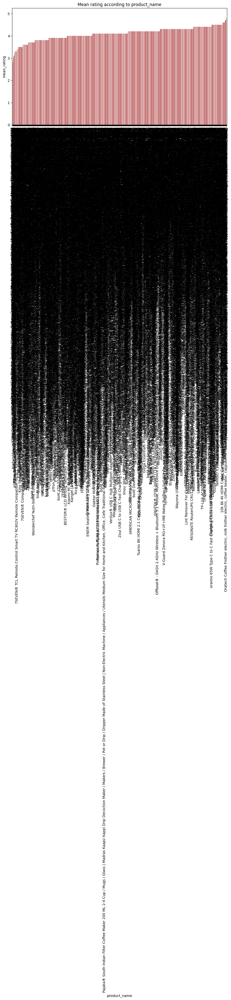

In [45]:
data.groupby('product_name')['rating'].mean().sort_values().plot.bar(color = 'brown', figsize=(11, 6))
plt.title("Mean rating according to product_name")
plt.xlabel('product_name')
plt.ylabel('mean_rating')
plt.show()

Analyzing 'review_content' column

In [ ]:
data['length'].describe()

count     1463.000000
mean      1395.680109
std       1824.248701
min         67.000000
25%        505.000000
50%        824.000000
75%       1392.000000
max      18547.000000
Name: length, dtype: float64

[Text(0.5, 1.0, 'Distribution of length of review ')]

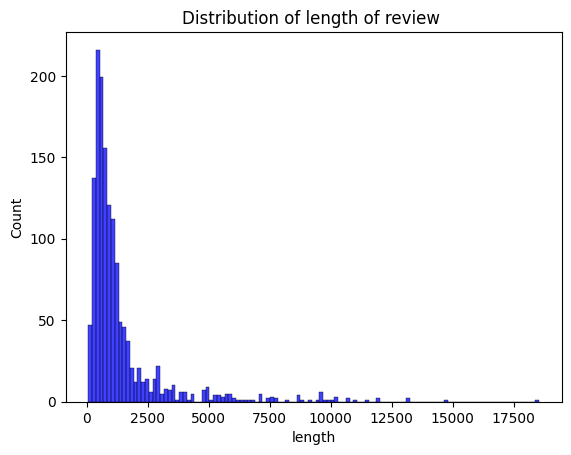

In [ ]:

sns.histplot(data['length'],color='blue').set(title='Distribution of length of review ')

[Text(0.5, 1.0, 'Distribution of length of review if feedback = 0')]

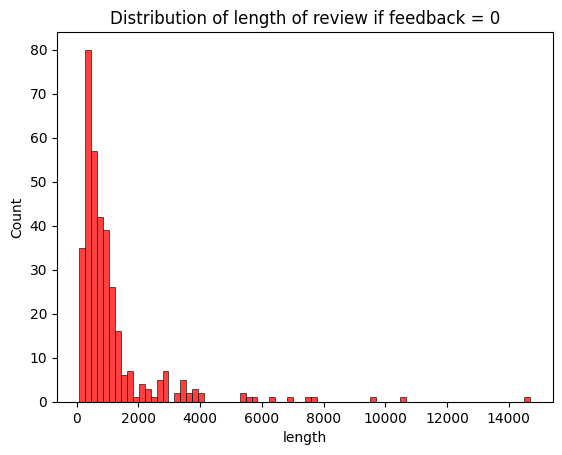

In [46]:
sns.histplot(data[data['feedback']==0]['length'],color='red').set(title='Distribution of length of review if feedback = 0')

[Text(0.5, 1.0, 'Distribution of length of review if feedback = 1')]

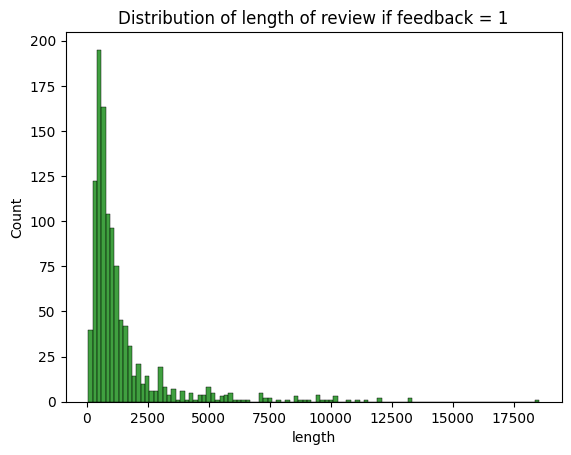

In [47]:
sns.histplot(data[data['feedback']==1]['length'],color='green').set(title='Distribution of length of review if feedback = 1')

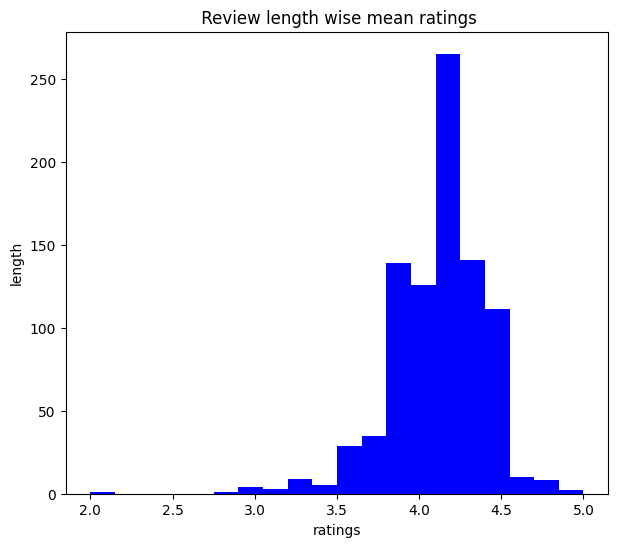

In [48]:
data.groupby('length')['rating'].mean().plot.hist(color = 'blue', figsize=(7, 6), bins = 20)
plt.title(" Review length wise mean ratings")
plt.xlabel('ratings')
plt.ylabel('length')
plt.show()

In [55]:
cv = CountVectorizer(stop_words='english')
words = cv.fit_transform(data.review_content)

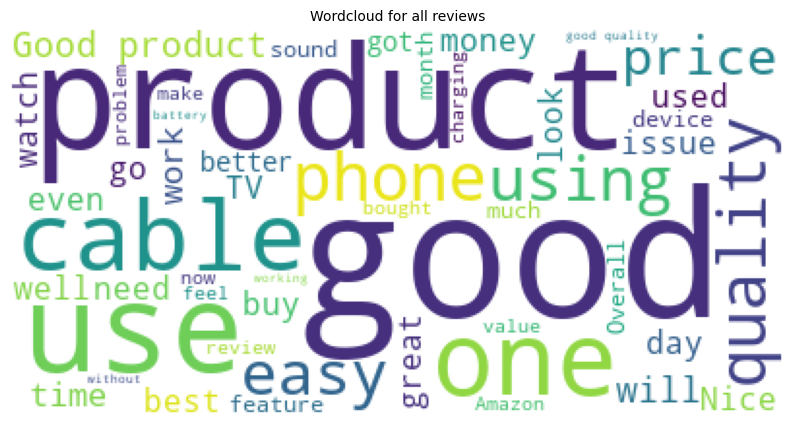

In [56]:
# Combine all reviews
reviews = " ".join([review for review in data['review_content']])
                        
# Initialize wordcloud object
wc = WordCloud(background_color='white', max_words=50)

# Generate and plot wordcloud
plt.figure(figsize=(10,10))
plt.imshow(wc.generate(reviews))
plt.title('Wordcloud for all reviews', fontsize=10)
plt.axis('off')
plt.show()

Lets find the unique words in each feedback category

In [62]:
# Combine all reviews for each feedback category and splitting them into individual words
neg_reviews = " ".join([review for review in data[data['feedback'] == 0]['review_content']])
neg_reviews = neg_reviews.lower().split()

pos_reviews = " ".join([review for review in data[data['feedback'] == 1]['review_content']])
pos_reviews = pos_reviews.lower().split()

#Finding words from reviews which are present in that feedback category only
unique_negative = [x for x in neg_reviews if x not in pos_reviews]
unique_negative = " ".join(unique_negative)

unique_positive = [x for x in pos_reviews if x not in neg_reviews]
unique_positive = " ".join(unique_positive)

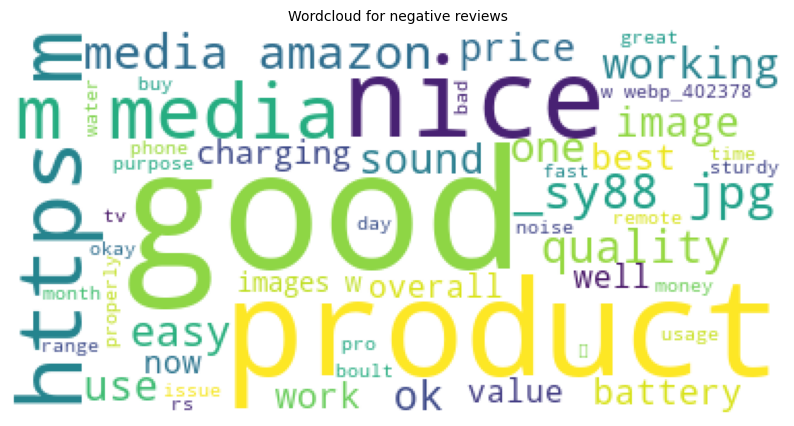

In [63]:
wc = WordCloud(background_color='white', max_words=50)

# Generate and plot wordcloud
plt.figure(figsize=(10,10))
plt.imshow(wc.generate(unique_negative))
plt.title('Wordcloud for negative reviews', fontsize=10)
plt.axis('off')
plt.show()

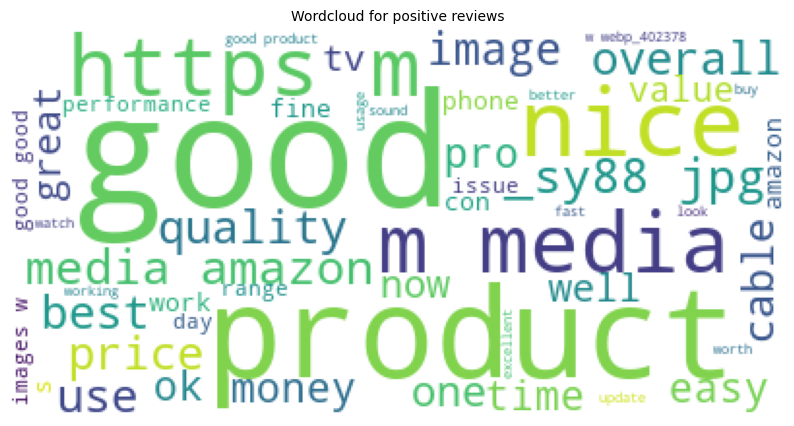

In [64]:
wc = WordCloud(background_color='white', max_words=50)

# Generate and plot wordcloud
plt.figure(figsize=(10,10))
plt.imshow(wc.generate(unique_positive))
plt.title('Wordcloud for positive reviews', fontsize=10)
plt.axis('off')
plt.show()

Preprocessing and Modelling

To build the corpus from the 'verified_reviews' we perform the following -

Replace any non alphabet characters with a space
Covert to lower case and split into words
Iterate over the individual words and if it is not a stopword then add the stemmed form of the word to the corpus

In [65]:
corpus = []
stemmer = PorterStemmer()
for i in range(0, data.shape[0]):
  review = re.sub('[^a-zA-Z]', ' ', data.iloc[i]['review_content'])
  review = review.lower().split()
  review = [stemmer.stem(word) for word in review if not word in STOPWORDS]
  review = ' '.join(review)
  corpus.append(review)

Using Count Vectorizer to create bag of words

In [66]:
cv = CountVectorizer(max_features = 2500)

#Storing independent and dependent variables in X and y
X = cv.fit_transform(corpus).toarray()
y = data['feedback'].values

In [69]:
#Saving the Count Vectorizer
pickle.dump(cv, open('Models/countVectorizer.pkl', 'wb'))

Checking the shape of X and y

In [70]:
print(f"X shape: {X.shape}")
print(f"y shape: {y.shape}")

X shape: (1463, 2500)
y shape: (1463,)


Splitting data into train and test set with 30% data with testing.

In [71]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 15)

print(f"X train: {X_train.shape}")
print(f"y train: {y_train.shape}")
print(f"X test: {X_test.shape}")
print(f"y test: {y_test.shape}")

X train: (1024, 2500)
y train: (1024,)
X test: (439, 2500)
y test: (439,)


In [72]:
print(f"X train max value: {X_train.max()}")
print(f"X test max value: {X_test.max()}")

X train max value: 55
X test max value: 52


In [73]:
scaler = MinMaxScaler()

X_train_scl = scaler.fit_transform(X_train)
X_test_scl = scaler.transform(X_test)

In [74]:
#Saving the scaler model
pickle.dump(scaler, open('Models/scaler.pkl', 'wb'))


Random Forest

In [75]:
#Fitting scaled X_train and y_train on Random Forest Classifier
model_rf = RandomForestClassifier()
model_rf.fit(X_train_scl, y_train)

RandomForestClassifier()

In [76]:
#Accuracy of the model on training and testing data
 
print("Training Accuracy :", model_rf.score(X_train_scl, y_train))
print("Testing Accuracy :", model_rf.score(X_test_scl, y_test))

Training Accuracy : 1.0
Testing Accuracy : 0.7995444191343963


In [77]:
#Predicting on the test set
y_preds = model_rf.predict(X_test_scl)

In [78]:
#Confusion Matrix
cm = confusion_matrix(y_test, y_preds)

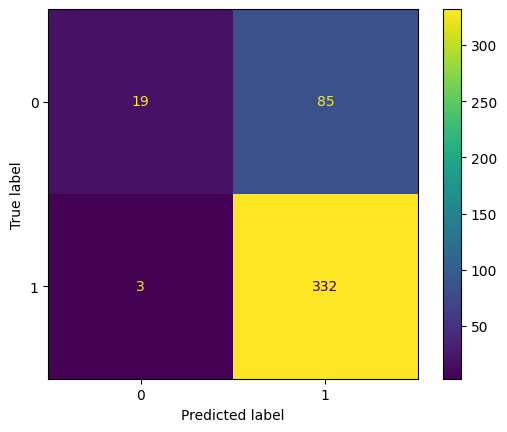

In [79]:
cm_display = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model_rf.classes_)
cm_display.plot()
plt.show()

K fold cross-validation

In [80]:
accuracies = cross_val_score(estimator = model_rf, X = X_train_scl, y = y_train, cv = 10)

print("Accuracy :", accuracies.mean())
print("Standard Variance :", accuracies.std())

Accuracy : 0.782181610508281
Standard Variance : 0.01947427890425645


Applying grid search to get the optimal parameters on random forest

In [82]:
params = {
    'bootstrap': [True],
    'max_depth': [80, 100],
    'min_samples_split': [8, 12],
    'n_estimators': [100, 300]
}

In [83]:
cv_object = StratifiedKFold(n_splits = 2)

grid_search = GridSearchCV(estimator = model_rf, param_grid = params, cv = cv_object, verbose = 0, return_train_score = True)
grid_search.fit(X_train_scl, y_train.ravel())

GridSearchCV(cv=StratifiedKFold(n_splits=2, random_state=None, shuffle=False),
             estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True], 'max_depth': [80, 100],
                         'min_samples_split': [8, 12],
                         'n_estimators': [100, 300]},
             return_train_score=True)

In [84]:
#Getting the best parameters from the grid search


print("Best Parameter Combination : {}".format(grid_search.best_params_))

Best Parameter Combination : {'bootstrap': True, 'max_depth': 80, 'min_samples_split': 8, 'n_estimators': 100}


In [85]:
print("Cross validation mean accuracy on train set : {}".format(grid_search.cv_results_['mean_train_score'].mean()*100))
print("Cross validation mean accuracy on test set : {}".format(grid_search.cv_results_['mean_test_score'].mean()*100))
print("Accuracy score for test set :", accuracy_score(y_test, y_preds))

Cross validation mean accuracy on train set : 97.6318359375
Cross validation mean accuracy on test set : 76.96533203125
Accuracy score for test set : 0.7995444191343963


XgBoost

In [86]:
model_xgb = XGBClassifier()
model_xgb.fit(X_train_scl, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [87]:
#Accuracy of the model on training and testing data
 
print("Training Accuracy :", model_xgb.score(X_train_scl, y_train))
print("Testing Accuracy :", model_xgb.score(X_test_scl, y_test))

Training Accuracy : 1.0
Testing Accuracy : 0.785876993166287


In [88]:
y_preds = model_xgb.predict(X_test)

In [89]:
#Confusion Matrix
cm = confusion_matrix(y_test, y_preds)
print(cm)

[[ 22  82]
 [ 19 316]]


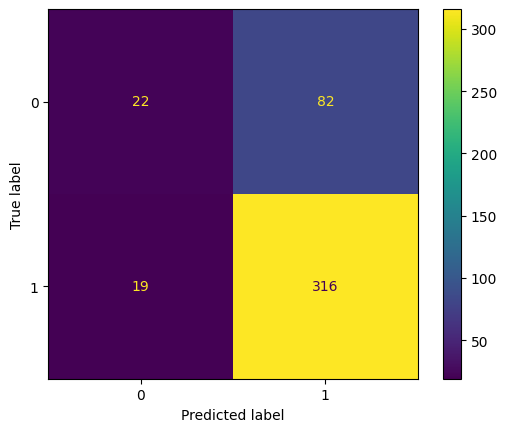

In [90]:
cm_display = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model_xgb.classes_)
cm_display.plot()
plt.show()

In [91]:
#Saving the XGBoost classifier
pickle.dump(model_xgb, open('Models/model_xgb.pkl', 'wb'))



Decision Tree Classifier

In [92]:
model_dt = DecisionTreeClassifier()
model_dt.fit(X_train_scl, y_train)

DecisionTreeClassifier()

In [93]:
#Accuracy of the model on training and testing data
 
print("Training Accuracy :", model_dt.score(X_train_scl, y_train))
print("Testing Accuracy :", model_dt.score(X_test_scl, y_test))

Training Accuracy : 1.0
Testing Accuracy : 0.7334851936218679


In [94]:
y_preds = model_dt.predict(X_test)


In [95]:
#Confusion Matrix
cm = confusion_matrix(y_test, y_preds)
print(cm)

[[ 50  54]
 [112 223]]


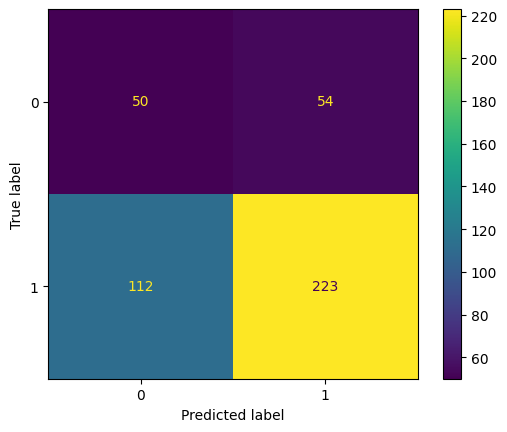

In [96]:
cm_display = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model_dt.classes_)
cm_display.plot()
plt.show()